# Case Study 1 : Collecting Data from NewsAPI

Due Date: 11/10/2023, **BEFORE the beginning of class at 12:00pm EST**

## **NOTE: There are *always* last minute issues submitting the case studies.  DO NOT WAIT UNTIL THE LAST MINUTE!**

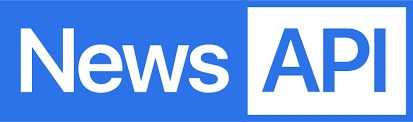

**TEAM Members:** Please EDIT this cell and add the names of all the team members in your team

    Jacob Ruppert
    
    Ryan Dalton
    
    Rohan Prasad

    Bishoy Soliman Hanna

    Tobias Chin
    

**Suggested Readings:**
* The NewsAPI documentation: https://newsapi.org/docs
* The Python library for NewsAPI: https://newsapi.org/docs/client-libraries/python
* The Pyhon notebook I used in class 3
  * In fact, it is intentional that many of these questions can be answered directly from there (except for question 4)!
* The idea is to ease you into the case studies :-)

**Don't forget!**
* You will need to install the newsapi-python library to access NewsAPI
 * pip install newsapi-python
* You will need to get an API key from NewsAPI to access the data
  * https://newsapi.org/register


** NOTE **
* **Please don't forget to save the notebook frequently when working in IPython Notebook, otherwise the changes you made can be lost**.

# Problem 1 (20 points): Sampling NewsAPI data a certain topic

* Select a topic that you are interested in, for example, "WPI" or "Lady Gaga"
* Use the NewsAPI to sample a collection of news articles about this topic. (It would be recommended that the number of articles should be larger than 200, but smaller than 100,000.
* Store the articles you downloaded into file on Google Drive (txt file or json file)

In [ ]:
! pip install newsapi-python

In [ ]:
from newsapi import NewsApiClient
import requests


# See https://newsapi.org/docs for more information
# on NewsAPI implementation.

API_KEY = 'a8a965707bd943e6abf3c8b42d2249ee'

newsapi = NewsApiClient(api_key=API_KEY)
print(newsapi)

# Pulling all ESPN football articles from the past month
ball_articles = newsapi.get_everything(q='football',
                                      sources='ESPN',
                                      from_param='2023-11-01',
                                      to='2023-11-06',
                                      language='en',
                                      sort_by='popularity')
print(ball_articles)

{'status': 'ok', 'totalResults': 167, 'articles': [{'source': {'id': 'espn', 'name': 'ESPN'}, 'author': 'Eric Karabell', 'title': 'Flex and superflex rankings', 'description': 'Trying to decide between a couple of closely ranked fantasy football players this week? Eric Karabell ranks the top 150 QBs, RBs, WRs and TEs to make the decision easy for you.', 'url': 'https://www.espn.com/fantasy/football/story/_/id/38793185/fantasy-football-superflex-rankings-2023-qb-rb-wr-te', 'urlToImage': 'https://a.espncdn.com/combiner/i?img=%2Fphoto%2F2023%2F1015%2Fr1238813_1296x729_16%2D9.jpg', 'publishedAt': '2023-11-01T14:54:34Z', 'content': 'Welcome to Week 9 of the 2023 NFL season and our weekly PPR fantasy football superflex rankings. We know many of you compete in superflex formats that invite/covet second quarterbacks in starting lin… [+10326 chars]'}, {'source': {'id': 'espn', 'name': 'ESPN'}, 'author': 'Dan Murphy', 'title': 'Athletes get class certification in case vs. NCAA', 'description': '

### Report some statistics about the news articles you collected

* The topic of interest: ESPN Football Articles


* The total number of news articles collected:  798

In [ ]:
#----------------------------------------------
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary

# Imports drive and saves football articles to shared drive as football.txt
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import json #please dont run it again the file has ben sent to everyone

data= json.dumps(ball_articles, indent=1)

file = open('gdrive/MyDrive/DS3010_Colab_Storage/football.txt','w')
file.write(data)
file.close()

In [ ]:
# Imports the football.txt as d allowing us to analyze the articles without repeatedly calling the API.
from IPython.display import Image
from IPython.core.display import HTML
import json #please dont run it again the file has ben sent to everyone

data= json.dumps(ball_articles, indent=1)

file = open('gdrive/MyDrive/DS3010_Colab_Storage/football.txt','r')
football = file.read()
d = json.loads(football)

# Shows a title and image of 3 of the articles in the dataset
for i in range(3):
  print(d['articles'][i]['title'])
  try:
    image = Image(url=d['articles'][i]['urlToImage'])
    display(image)
  except ValueError:
    print('no image')

'We're giving everybody rides': Utah football players get free trucks


Cricket, flag football added as '28 Olympic sports


49ers' Brock Purdy, George Kittle connect for 19-yard TD


In [ ]:
# Heres the area for the 'statistics' we need for pt1
import time
from collections import Counter

authors = [ article['author'] for article in d['articles'] ]

sources = [ article['source']['name'] for article in d['articles'] ]

titles = [ article['title'] for article in d['articles'] ]

# Collection of words from all article titles, and the resulting top 10 most used words
words = [ w
          for d in titles
              for w in d.split() ]

for item in [authors, sources, words]:
    c = Counter(item)
    print(c.most_common()[:10]) # top 10

[(None, 9), ('ESPN staff', 5), ('Alaina Getzenberg', 5), ('Rich Cimini', 4), ('ESPN Fantasy', 3), ('Eric Moody and NFL Nation', 3), ('Adam Teicher', 3), ('John Keim', 3), ('Eric Karabell', 3), ('Kalan Hooks', 2)]
[('ESPN', 100)]
[('to', 29), ('the', 19), ('for', 18), ('in', 12), ('and', 11), ('football', 9), ('NFL', 9), ('at', 9), ('of', 9), ('Week', 8)]


*-----------------------

# Problem 2 (20 points): Analyzing News Articles with Frequency Analysis

**1. Word Count:**
* Use the news articles you collected in Problem 1, and compute the frequencies of the words being used in these articles.
* Note, you can use various parts of the articles (e.g. the tite, the description, the content) to compute the word frequencies.
  * Which is most useful?
* Plot a table of the top 30 words with their counts

*Hint: One way to make very easy and asethestic way to make tables in Python is using the PrettyTable package. While using PrettyTable is not required for full credit, some starter code for using them is provided for Question 2.1 and 2.2*  

In [ ]:
! pip install prettytable
from prettytable import PrettyTable

# Example Table
example_table = PrettyTable() # Initialize Table
example_table.field_names = ["Course Name", "Department"] # Declare column names

# Add each row
example_table.add_row(["DS3010", "Data Science"])
example_table.add_row(["CS4120", "Computer Science"])
example_table.add_row(["MIS 4084", "Business"])

# Display table
print(example_table)

+-------------+------------------+
| Course Name |    Department    |
+-------------+------------------+
|    DS3010   |   Data Science   |
|    CS4120   | Computer Science |
|   MIS 4084  |     Business     |
+-------------+------------------+


In [ ]:
#----------------------------------------------
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary

#This creates a PrettyTable of the top 30 most used words in the titles of our articles
for label, data in (('Word', words),
                    # ('Author', authors),
                    # ('Source', sources)
                    ):
    football_table = PrettyTable(field_names=[label, 'Count'])
    c = Counter(data)
    [ football_table.add_row(kv) for kv in c.most_common()[:25] ]
    football_table.align[label], football_table.align['Count'] = 'l', 'r' # Set column alignment
    print(football_table)


+----------+-------+
| Word     | Count |
+----------+-------+
| to       |    29 |
| the      |    19 |
| for      |    18 |
| in       |    12 |
| and      |    11 |
| football |     9 |
| NFL      |     9 |
| at       |     9 |
| of       |     9 |
| Week     |     8 |
| a        |     8 |
| How      |     7 |
| with     |     6 |
| win      |     6 |
| Man      |     6 |
| QB       |     5 |
| on       |     5 |
| return   |     5 |
| vs.      |     5 |
| United   |     5 |
| as       |     4 |
| after    |     4 |
| from     |     4 |
| Fantasy  |     4 |
| his      |     4 |
+----------+-------+


**2. Find the most popular news sources and authors in your articles**

* Please provide a table of the top 10 authors and sources that are the most popular among your collection.


In [ ]:

#----------------------------------------------

#This creates a PrettyTable of the top 10 most popular authors/sources
for label, data in (('Author', authors),
                    ('Source', sources)
                    ):
    football_table = PrettyTable(field_names=[label, 'Count'])
    c = Counter(data)
    [ football_table.add_row(kv) for kv in c.most_common()[:10] ]
    football_table.align[label], football_table.align['Count'] = 'l', 'r'
    print(football_table)



+---------------------------+-------+
| Author                    | Count |
+---------------------------+-------+
| None                      |     9 |
| ESPN staff                |     5 |
| Alaina Getzenberg         |     5 |
| Rich Cimini               |     4 |
| ESPN Fantasy              |     3 |
| Eric Moody and NFL Nation |     3 |
| Adam Teicher              |     3 |
| John Keim                 |     3 |
| Eric Karabell             |     3 |
| Kalan Hooks               |     2 |
+---------------------------+-------+
+--------+-------+
| Source | Count |
+--------+-------+
| ESPN   |   100 |
+--------+-------+


**3. What is the lexical diversity in your descriptions and contents**

* For two popular authors or two popular sources, please compare the lexical diversity of their descriptions and contents.  
Which one is more diverse?  
  * Open ended questions: Does this make sense?  Why or why not? What might lexical diversity tell us about the author or source?

In [ ]:
# Define the lexical_diversity function
def lexical_diversity(tokens):
    return 1.0 * len(set(tokens)) / len(tokens)

# Load data from the text file
file_path = '/content/gdrive/MyDrive/DS3010_Colab_Storage/football.txt'
with open(file_path, 'r') as file:
    data = json.load(file)

# Initialize lists for descriptions, contents, authors, and sources
descriptions = []
contents = []
authors = []
sources = []

# Extract data from each article
for article in data['articles']:
    descriptions.append(article.get('description', ''))
    contents.append(article.get('content', ''))
    authors.append(article.get('author', ''))
    sources.append(article['source']['name'])

# Calculate lexical diversity for descriptions and contents
description_lexical_diversity = lexical_diversity(" ".join(descriptions).split())
content_lexical_diversity = lexical_diversity(" ".join(contents).split())

# Calculate the lexical diversity for authors and sources
author_lexical_diversity = {}
source_lexical_diversity = {}

for author in set(authors):
    author_articles = [content for content, a in zip(contents, authors) if a == author]
    author_lexical_diversity[author] = lexical_diversity(" ".join(author_articles).split())

for source in set(sources):
    source_articles = [content for content, s in zip(contents, sources) if s == source]
    source_lexical_diversity[source] = lexical_diversity(" ".join(source_articles).split())

# Find the two most popular authors
popular_authors = Counter(authors).most_common(2)

# Find the two most popular sources
popular_sources = Counter(sources).most_common(2)

# Compare lexical diversity for popular authors and sources
print("Lexical Diversity Comparison:")
for author, _ in popular_authors:
    print(f"Author: {author}, Lexical Diversity: {author_lexical_diversity.get(author, 0.0)}")

for source, _ in popular_sources:
    print(f"Source: {source}, Lexical Diversity: {source_lexical_diversity.get(source, 0.0)}")

#------------------------------------------------------------------------------------#
# A lexical diversity score of 0 indicates that there is no diversity,
# meaning that every word in the text is the same.
#  This would happen if the text contains only one unique word repeated multiple times.

# A lexical diversity score of 1 indicates the highest level of diversity,
# where every word in the text is unique, and there is no repetition of words.


Lexical Diversity Comparison:
Author: None, Lexical Diversity: 0.6927710843373494
Author: ESPN staff, Lexical Diversity: 0.7239583333333334
Source: ESPN, Lexical Diversity: 0.4293208172280508




# Problem 3 (20 points): Image processing


* For each news article, download the image associated with it (using the urlToImage field).
* Do these images tell you anything about the news articles?  If so, what?

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 493.7/493.7 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 31.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 11.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 49.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 31.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 62.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 59.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 25.3 MB/s eta 0:00:00


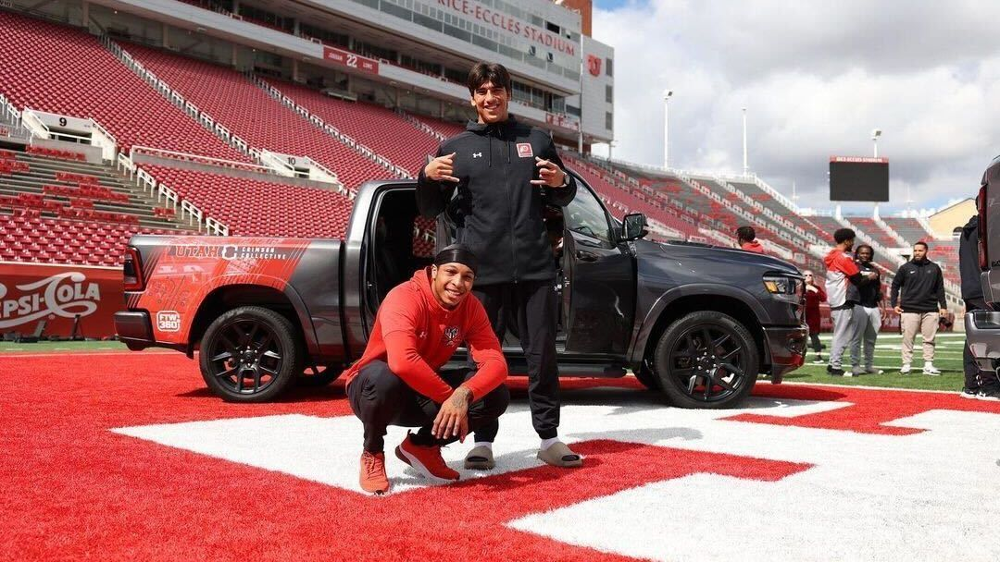

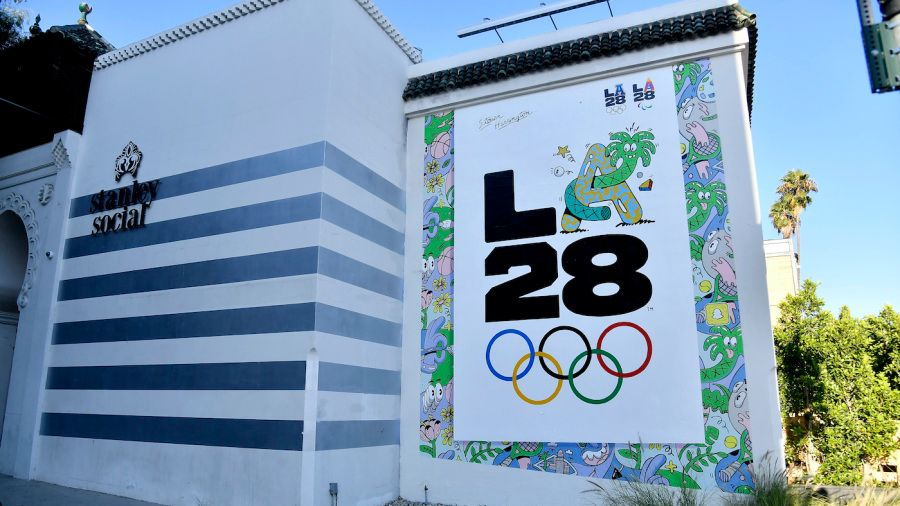

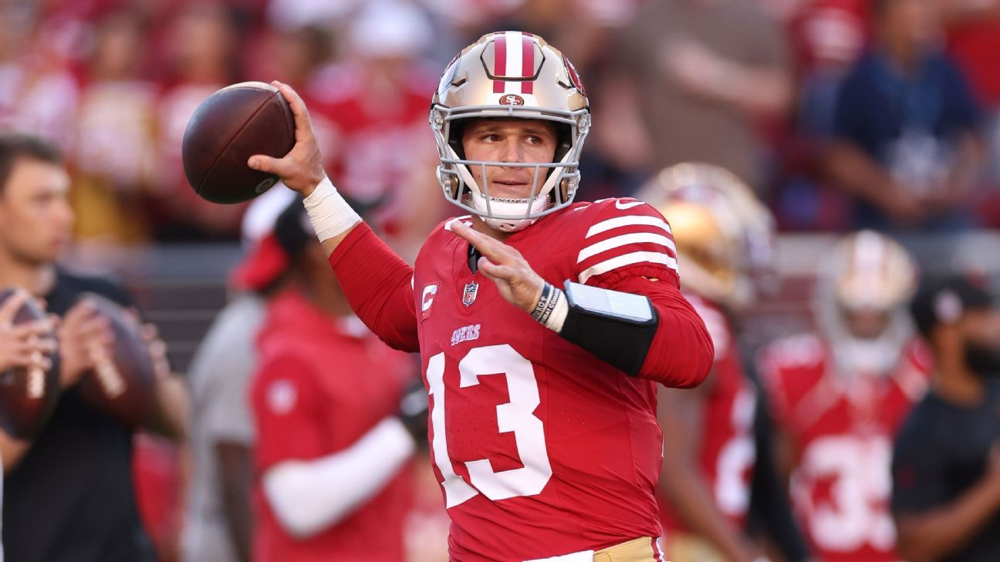

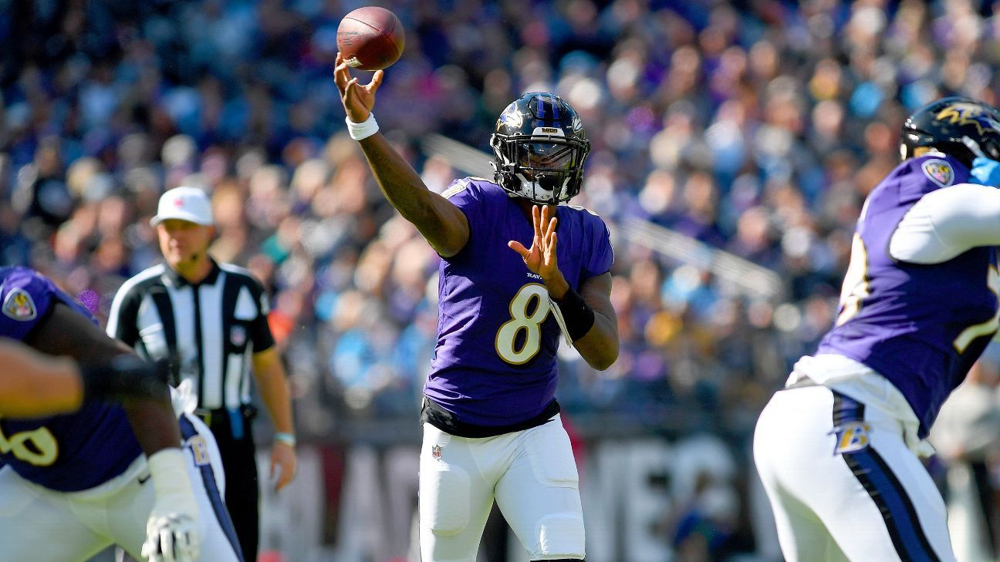

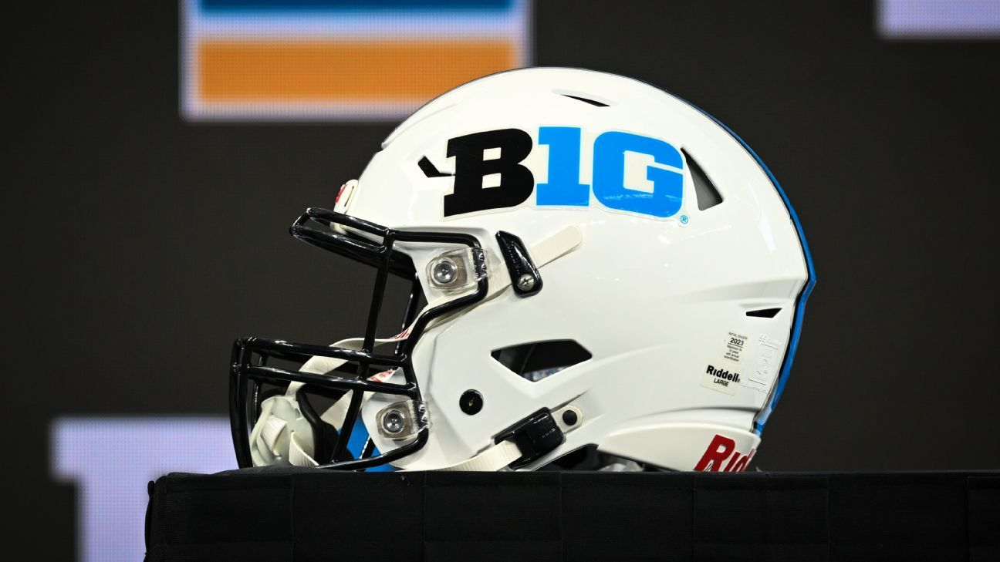

...

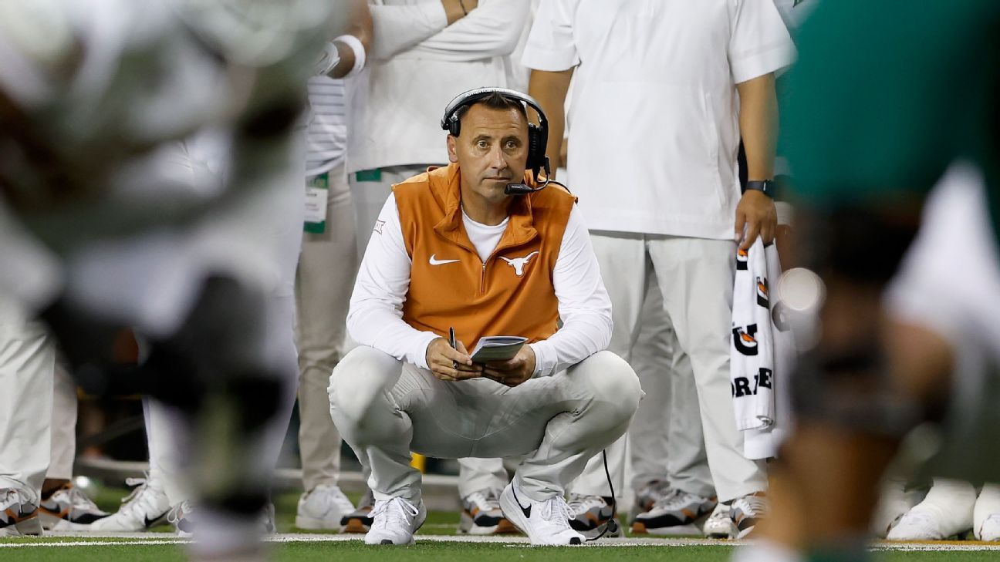

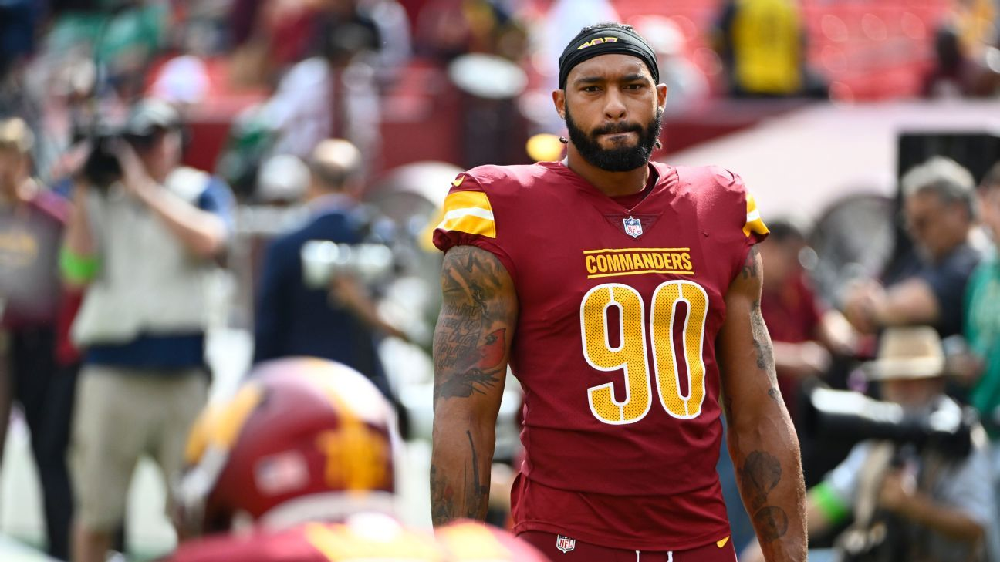

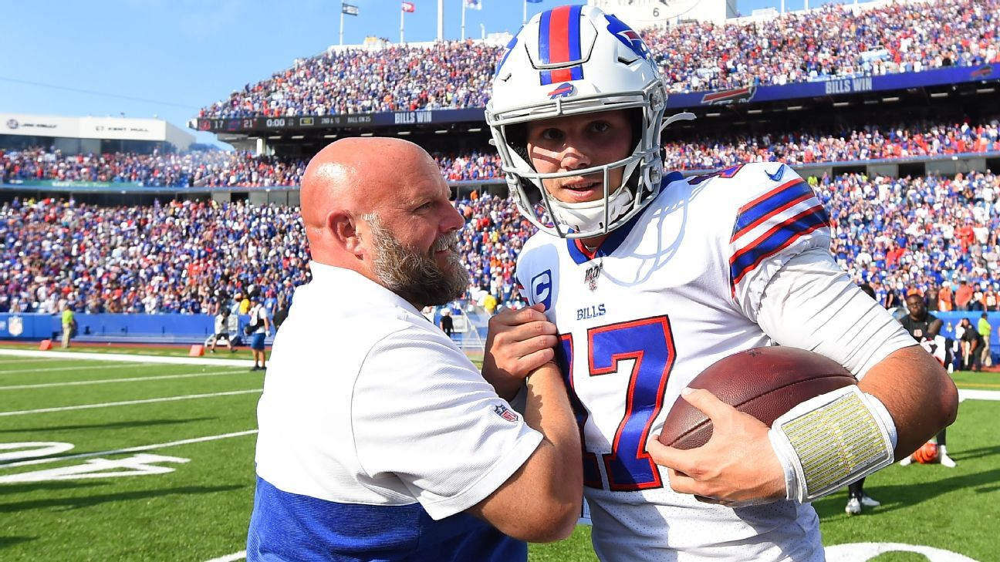

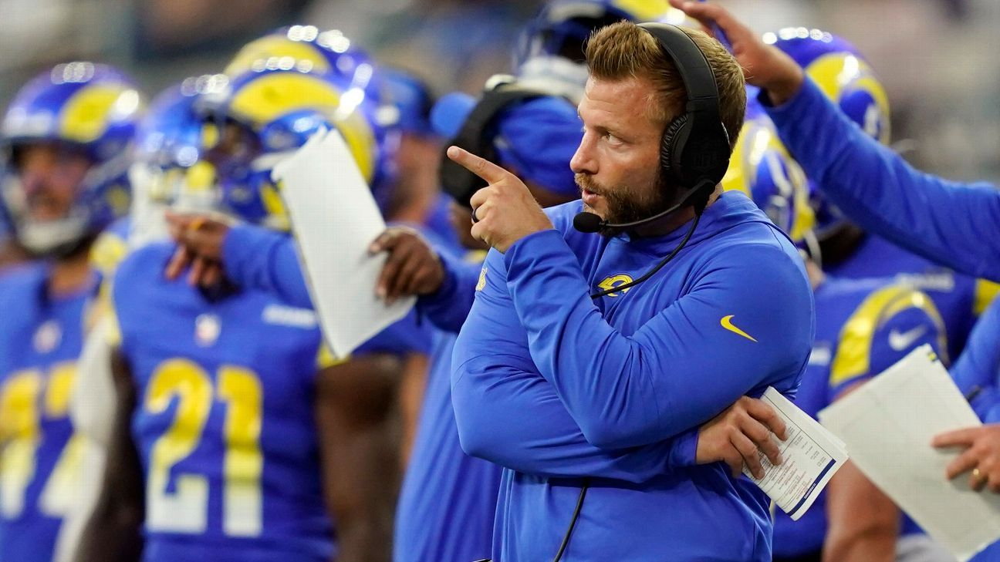

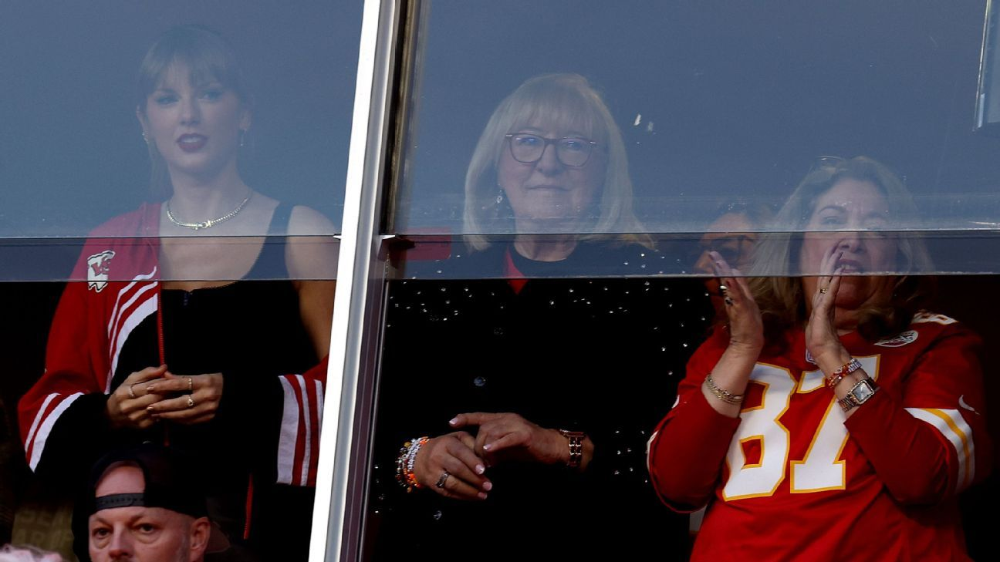

In [ ]:
#----------------------------------------------
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary
! pip install -q datasets transformers evaluate timm albumentations

from huggingface_hub import notebook_login

notebook_login()

import json
import requests

from IPython.display import Image, display

articles = d['articles']

# Download and display the images
for idx, article in enumerate(articles):
    image_url = article.get('urlToImage')
    if image_url:
        response = requests.get(image_url)
        if response.status_code == 200:
            image_data = response.content
            image_display = Image(data=image_data)
            display(image_display)




* Let's automate the process!  Use Hugging Face's transformers library to download a pre-trained image segmentation model.
  * See my notebook from class 3 for an example of how to do this.
* Open ended question: Collect statistics on what appears in the images for your news articles? What does this tell you?

In [ ]:
pip install -q datasets transformers evaluate timm albumentations

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

In [ ]:
#----------------------------------------------
# Actual image processing is carried out in problem 4: Business question

from transformers import pipeline #DonkeyWT/Football
import requests
from PIL import Image, ImageDraw

image_urls = [article["urlToImage"] for article in articles[:10]]
image_data_list = [Image.open(requests.get(url, stream=True).raw) for url in image_urls if url]

obj_detector = pipeline("object-detection")




No model was supplied, defaulted to facebook/detr-resnet-50 and revision 2729413 (https://huggingface.co/facebook/detr-resnet-50).
Using a pipeline without specifying a model name and revision in production is not recommended.
Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a 



# Problem 4 (20 points): Business question

Run some additional experiments with your data to gain familiarity with the NewsAPI.

* Come up with a business question that NewsAPI data could help answer.
* Decribe the business case.
* How could NewsAPI data help a company decide how to spend its resources.

In [ ]:
from PIL import Image, ImageDraw
from transformers import pipeline
import requests

# Initialize object detection pipeline with DETR model
object_detector = pipeline("object-detection", model="Yntec/BrandiMilne")

# Assuming 'image_urls' have the URLs of your images
for image_url in image_urls:
    # Load the image
    if image_url.startswith("http"):
        image = Image.open(requests.get(image_url, stream=True).raw)
    else:
        image = Image.open(image_url)

    # Use Hugging Face object detection pipeline
    results = object_detector(image)

    # Draw bounding boxes on the image
    draw = ImageDraw.Draw(image)

    # Get the predictions and draw bounding boxes
    for result in results:
      score, label, box = result["score"], result["label"], result["box"]
      x, y, x2, y2 = box['xmin'], box['ymin'], box['xmax'], box['ymax'],
      draw.rectangle((x, y, x2, y2), outline="red", width=1)
      draw.text((x, y), label, fill="white")

    # Save or display the processed image
    image_path = f'path_to_save_result_{image_url.split("/")[-1]}.png'
    image.save(image_path)
    display(image)



The model 'BertForMaskedLM' is not supported for object-detection. Supported models are ['ConditionalDetrForObjectDetection', 'DeformableDetrForObjectDetection', 'DetaForObjectDetection', 'DetrForObjectDetection', 'TableTransformerForObjectDetection', 'YolosForObjectDetection', 'AlbertForTokenClassification', 'BertForTokenClassification', 'BigBirdForTokenClassification', 'BioGptForTokenClassification', 'BloomForTokenClassification', 'BrosForTokenClassification', 'CamembertForTokenClassification', 'CanineForTokenClassification', 'ConvBertForTokenClassification', 'Data2VecTextForTokenClassification', 'DebertaForTokenClassification', 'DebertaV2ForTokenClassification', 'DistilBertForTokenClassification', 'ElectraForTokenClassification', 'ErnieForTokenClassification', 'ErnieMForTokenClassification', 'EsmForTokenClassification', 'FalconForTokenClassification', 'FlaubertForTokenClassification', 'FNetForTokenClassification', 'FunnelForTokenClassification', 'GPT2ForTokenClassification', 'GPT2Fo

TypeError: ignored

In [ ]:

from PIL import Image, ImageDraw
from transformers import pipeline
import requests
import os
import re

# Initialize object detection pipelines with different models
models = ["facebook/detr-resnet-101", "microsoft/vit-base-patch16-224-in21k-finetuned-imagenet-object-detection"]

brand_labels = []

def clean_filename(url):
    # Extract the filename from the URL and replace invalid characters
    filename = os.path.basename(url)
    cleaned_filename = re.sub(r'[\\/*?:"<>|]', '_', filename)
    return cleaned_filename

for image_url in image_urls:
    # Load the image
    if image_url.startswith("http"):
        image = Image.open(requests.get(image_url, stream=True).raw)
    else:
        image = Image.open(image_url)

    # Iterate through different models
    for model_name in models:
        # Use Hugging Face object detection pipeline
        object_detector = pipeline("object-detection", model=model_name)
        results = object_detector(image)

        # Draw bounding boxes on the image
        draw = ImageDraw.Draw(image)

        # Get the predictions and draw bounding boxes
        for result in results:
            score, label, box = result["score"], result["label"], result["box"]
            x, y, x2, y2 = box['xmin'], box['ymin'], box['xmax'], box['ymax']
            draw.rectangle((x, y, x2, y2), outline="red", width=1)
            draw.text((x, y), label, fill="white")

            # Collect brand labels
            brand_labels.append(label)

        # Save or display the processed image
        # Ensure the directory exists
        os.makedirs("path_to_save_results", exist_ok=True)
        cleaned_filename = clean_filename(image_url)
        image_path = f'path_to_save_results/{model_name}_{cleaned_filename}.png'
        image.save(image_path)
        display(image)

# Now, brand_labels contains the labels of the brands detected by different models in all images
print("Detected brands:", brand_labels)




Some weights of the model checkpoint at facebook/detr-resnet-101 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Could not find image processor class in the image processor config or the model con

FileNotFoundError: ignored


# Done

All set!

** What do you need to submit?**

* **Notebook File**: Save this IPython notebook, and find the notebook file in your folder (for example, "filename.ipynb"). This is the file you need to submit. Please make sure all the plotted tables and figures are in the notebook. If you used "ipython notebook --pylab=inline" to open the notebook, all the figures and tables should have shown up in the notebook.


* **PPT Slides**: please prepare PPT slides (for 15 minutes' talk) to present about the case study . We will ask two teams which are randomly selected to present their case studies in class for this case study.

* ** Report**: please prepare a report (less than 10 pages) to report what you found in the data.
    * What data you collected?
    * Why this topic is interesting or important to you? (Motivations)
    * How did you analyse the data?
    * What did you find in the data?

     (please include figures or tables in the report, but no source code)

Please compress all the files in a zipped file.


** How to submit: **

        Please submit through email to Prof. Paffenroth (rcpaffenroth@wpi.edu) *and* the TA (???).

#### We auto-process the submissions so make sure your subject line is *exactly*:

### DS3010 Case Study 1 Team ??

#### where ?? is your team number.
        
** Note: Each team just needs to submits one submission **

# Grading Criteria:

** Totoal Points: 100 **


---------------------------------------------------------------------------
** Notebook results:  **
    Points: 80


    -----------------------------------
    Qestion 1:
    Points: 20
    -----------------------------------
    
    (1) Select a topic that you are interested in.
    Points: 6
    
    (2) Use the NewsAPI to sample a collection of news articles about this topic. (It would be recommended that the number of articles should be larger than 200, but smaller than 100,000. Please check whether the total number of tweets collected is larger than 200.
    Points: 10
    
    
    (3) Store the articles you downloaded into a file on Google Drive (txt file or json file)
    Points: 4
    
    
    -----------------------------------
    Qestion 2:
    Points: 20
    -----------------------------------
    
    1. Word Count

    (1) Use the news articles you collected in Problem 1, and compute the frequencies of the words being used in these articles.
    Points: 5

    (2) Plot a table of the top 30 words with their counts
    Points: 5
    
    2. Please provide a table of the top 10 authors and sources that are the most popular among your collection.
    Points: 5
    
    3. For two popular authors or two popular sources, please compare the lexical diversity of their descriptions and contents.
    Points: 5
      
    -----------------------------------
    Qestion 3:
    Points: 20
    -----------------------------------
    
    (1) For each news article, download the image associated with it (using the urlToImage field).
    Points: 10

    (2) Use Hugging Face's transformers library to download a pre-trained image segmentation model.
    Points: 10
  
    -----------------------------------
    Qestion 4:  Business question
    Points: 20
    -----------------------------------
        Novelty: 10
        Interestingness: 10
    -----------------------------------
    Run some additional experiments with your data to gain familiarity with the NewsAPI.  Come up with a business question and describe how NewsAPI data can help you answer that question.



---------------------------------------------------------------------------
**Slides (for presentation): Story-telling**
    Points: 20


1. Motivation about the data collection, why the topic is interesting to you.
    Points: 5

2. Communicating Results (figure/table)
    Points: 10

3. Story telling (How all the parts (data, analysis, result) fit together as a story?)
    Points: 5



In [ ]:
# ! pip install -q datasets transformers evaluate timm albumentations

# from huggingface_hub import notebook_login

# notebook_login()

# import json
# import requests

# from IPython.display import Image, display

# articles = d['articles']

# # Download and display the images
# for idx, article in enumerate(articles):
#     image_url = article.get('urlToImage')
#     if image_url:
#         response = requests.get(image_url)
#         if response.status_code == 200:
#             image_data = response.content
#             image_display = Image(data=image_data)
#             display(image_display)
